<a href="https://colab.research.google.com/github/BuesraKaraoglan/Explainable-Artificial-Intelligence/blob/main/Karaoglan_Masterarbeit_XAI.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Import Libraries**


In [ ]:
# LIME and SHAP packages have to be installed via pip
# The %%capture command hide code cell output in Google Colab
%%capture
!pip install lime
!pip install shap

In [ ]:
from google.colab import files
import io

import pandas as pd
import numpy as np
import tensorflow as tf
import time

# Plot results
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline

# Data preparation and pre-processing
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import train_test_split

# Model classifiers
from sklearn.svm import SVC
from sklearn.ensemble import RandomForestClassifier
from sklearn.neural_network import MLPClassifier

# Classifier metrics
from sklearn import metrics
from sklearn.metrics import accuracy_score,classification_report,confusion_matrix, f1_score, precision_score, recall_score, roc_auc_score

# Resample dataset
import collections
from imblearn.over_sampling import SMOTE

# Explainability
import lime
from lime.lime_tabular import LimeTabularExplainer
from lime import submodular_pick
import shap

import warnings
warnings.filterwarnings("ignore")

/usr/local/lib/python3.6/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm
/usr/local/lib/python3.6/dist-packages/sklearn/externals/six.py:31: FutureWarning: The module is deprecated in version 0.21 and will be removed in version 0.23 since we've dropped support for Python 2.7. Please rely on the official version of six (https://pypi.org/project/six/).
  "(https://pypi.org/project/six/).", FutureWarning)
/usr/local/lib/python3.6/dist-packages/sklearn/utils/deprecation.py:144: FutureWarning: The sklearn.neighbors.base module is  deprecated in version 0.22 and will be removed in version 0.24. The corresponding classes / functions should instead be imported from sklearn.neighbors. Anything that cannot be imported from sklearn.neighbors is now part of the private API.
  warnings.warn(message, FutureWarning)


# **Data Upload and Cleaning**

In [ ]:
# Upload the Credit Card Default dataset with google.colab.files
# Wait till the upload is 100%
uploaded = files.upload()

Saving DefaultOfCreditCardClients.csv to DefaultOfCreditCardClients.csv


In [ ]:
# Read the dataset from the excel file
data = pd.read_csv(io.BytesIO(uploaded['DefaultOfCreditCardClients.csv']), sep=";", header=1)

In [ ]:
data.head(3)

,ID,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_0,PAY_2,PAY_3,PAY_4,PAY_5,PAY_6,BILL_AMT1,BILL_AMT2,BILL_AMT3,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,default payment next month
0,1,20000,2,2,1,24,2,2,-1,-1,-2,-2,3913,3102,689,0,0,0,0,689,0,0,0,0,1
1,2,120000,2,2,2,26,-1,2,0,0,0,2,2682,1725,2682,3272,3455,3261,0,1000,1000,1000,0,2000,1
2,3,90000,2,2,2,34,0,0,0,0,0,0,29239,14027,13559,14331,14948,15549,1518,1500,1000,1000,1000,5000,0


In [ ]:
# Dataset without the ID column
data.drop('ID',axis=1, inplace=True)

In [ ]:
# Checking missing values - there aren't any non-null values
#data.isnull().sum()

In [ ]:
# Statistical description
data.describe()
# There are unusal values for PAY_0-PAY_6 the -2, for MARRIAGE the 0 or EDUCATION the 6
# Therefore clean the data

,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_0,PAY_2,PAY_3,PAY_4,PAY_5,PAY_6,BILL_AMT1,BILL_AMT2,BILL_AMT3,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,default payment next month
count,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,3.000000e+04,30000.000000,30000.000000,30000.000000,30000.000000,3.000000e+04,30000.00000,30000.000000,30000.000000,30000.000000,30000.000000
mean,167484.322667,1.603733,1.853133,1.551867,35.485500,-0.016700,-0.133767,-0.166200,-0.220667,-0.266200,-0.291100,51223.330900,49179.075167,4.701315e+04,43262.948967,40311.400967,38871.760400,5663.580500,5.921163e+03,5225.68150,4826.076867,4799.387633,5215.502567,0.221200
std,129747.661567,0.489129,0.790349,0.521970,9.217904,1.123802,1.197186,1.196868,1.169139,1.133187,1.149988,73635.860576,71173.768783,6.934939e+04,64332.856134,60797.155770,59554.107537,16563.280354,2.304087e+04,17606.96147,15666.159744,15278.305679,17777.465775,0.415062
min,10000.000000,1.000000,0.000000,0.000000,21.000000,-2.000000,-2.000000,-2.000000,-2.000000,-2.000000,-2.000000,-165580.000000,-69777.000000,-1.572640e+05,-170000.000000,-81334.000000,-339603.000000,0.000000,0.000000e+00,0.00000,0.000000,0.000000,0.000000,0.000000
25%,50000.000000,1.000000,1.000000,1.000000,28.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,3558.750000,2984.750000,2.666250e+03,2326.750000,1763.000000,1256.000000,1000.000000,8.330000e+02,390.00000,296.000000,252.500000,117.750000,0.000000
50%,140000.000000,2.000000,2.000000,2.000000,34.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,22381.500000,21200.000000,2.008850e+04,19052.000000,18104.500000,17071.000000,2100.000000,2.009000e+03,1800.00000,1500.000000,1500.000000,1500.000000,0.000000
75%,240000.000000,2.000000,2.000000,2.000000,41.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,67091.000000,64006.250000,6.016475e+04,54506.000000,50190.500000,49198.250000,5006.000000,5.000000e+03,4505.00000,4013.250000,4031.500000,4000.000000,0.000000
max,1000000.000000,2.000000,6.000000,3.000000,79.000000,8.000000,8.000000,8.000000,8.000000,8.000000,8.000000,964511.000000,983931.000000,1.664089e+06,891586.000000,927171.000000,961664.000000,873552.000000,1.684259e+06,896040.00000,621000.000000,426529.000000,528666.000000,1.000000


In [ ]:
# Rename PAY_0 and Target column
data = data.rename(columns={'PAY_0': 'PAY_1', 'default payment next month': 'Default Payment'})

In [ ]:
data.loc[data['SEX']==2,'SEX'] = 0
data.loc[data['MARRIAGE'] == 0, 'MARRIAGE'] = 3
clean_education = (data['EDUCATION'] == 0) | (data['EDUCATION'] == 5) | (data['EDUCATION'] == 6)
data.loc[clean_education, 'EDUCATION'] = 4

In [ ]:
clean_pay1 = (data['PAY_1'] == -2) | (data['PAY_1'] == -1)
data.loc[clean_pay1, 'PAY_1'] = 0
clean_pay2 = (data['PAY_2'] == -2) | (data['PAY_2'] == -1)
data.loc[clean_pay2, 'PAY_2'] = 0
clean_pay3 = (data['PAY_3'] == -2) | (data['PAY_3'] == -1)
data.loc[clean_pay3, 'PAY_3'] = 0
clean_pay4 = (data['PAY_4'] == -2) | (data['PAY_4'] == -1)
data.loc[clean_pay4, 'PAY_4'] = 0
clean_pay5 = (data['PAY_5'] == -2) | (data['PAY_5'] == -1)
data.loc[clean_pay5, 'PAY_5'] = 0
clean_pay6 = (data['PAY_6'] == -2) | (data['PAY_6'] == -1)
data.loc[clean_pay6, 'PAY_6'] = 0
#data[['PAY_1', 'PAY_2', 'PAY_3', 'PAY_4', 'PAY_5', 'PAY_6']].describe()

# **Simple Exploratory Data Analysis**

0    18112
1    11888
Name: SEX, dtype: int64


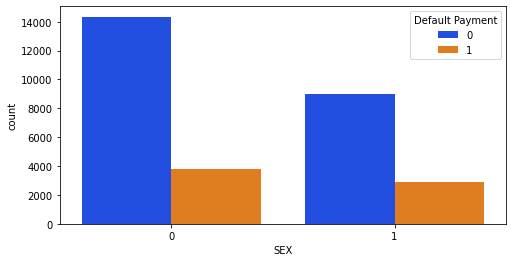

In [ ]:
print(data['SEX'].value_counts())
plt.figure(figsize=(8,4))
sns.countplot(x='SEX', data=data, hue='Default Payment', palette='bright')

2    15964
1    13659
3      377
Name: MARRIAGE, dtype: int64


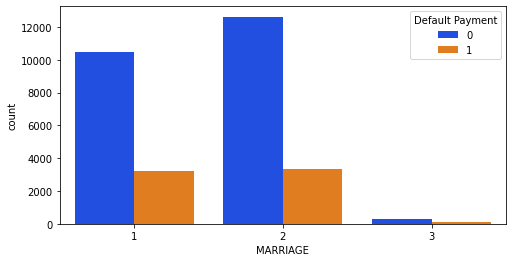

In [ ]:
print(data['MARRIAGE'].value_counts())
plt.figure(figsize=(8,4))
sns.countplot(x='MARRIAGE', data=data, hue='Default Payment', palette='bright')

2    14030
1    10585
3     4917
4      468
Name: EDUCATION, dtype: int64


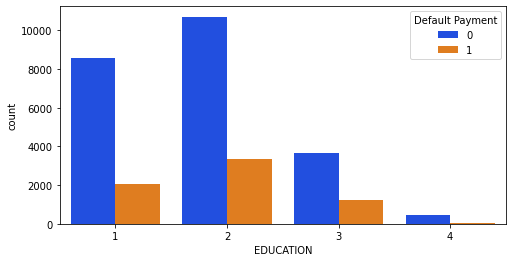

In [ ]:
print(data['EDUCATION'].value_counts())
plt.figure(figsize=(8,4))
sns.countplot(x='EDUCATION', data=data, hue='Default Payment', palette='bright')

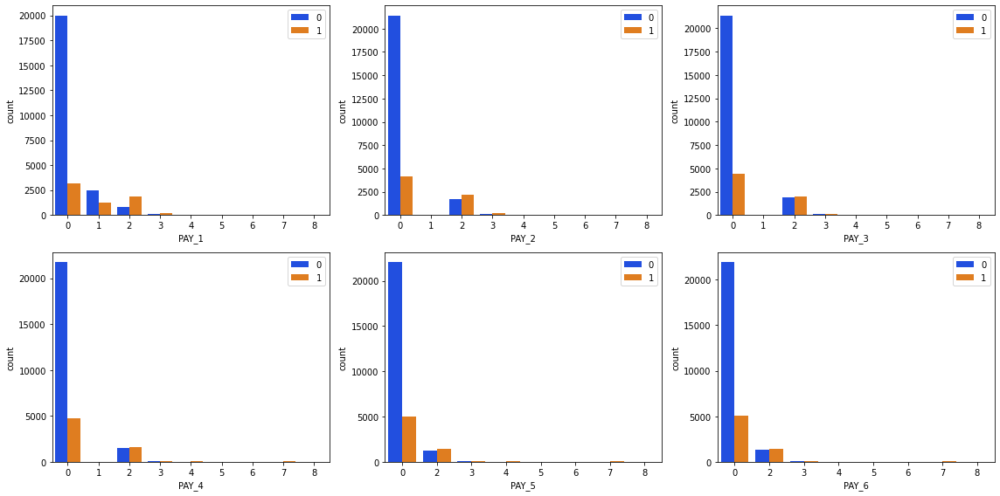

In [ ]:
fig, ax =plt.subplots(2,3)
fig.set_size_inches(16,8)
sns.countplot(x='PAY_1', data=data, hue='Default Payment', palette='bright', ax=ax[0,0]).legend(loc="upper right")
sns.countplot(x='PAY_2', data=data, hue='Default Payment', palette='bright', ax=ax[0,1]).legend(loc="upper right")
sns.countplot(x='PAY_3', data=data, hue='Default Payment', palette='bright', ax=ax[0,2]).legend(loc="upper right")
sns.countplot(x='PAY_4', data=data, hue='Default Payment', palette='bright', ax=ax[1,0]).legend(loc="upper right")
sns.countplot(x='PAY_5', data=data, hue='Default Payment', palette='bright', ax=ax[1,1]).legend(loc="upper right")
sns.countplot(x='PAY_6', data=data, hue='Default Payment', palette='bright', ax=ax[1,2]).legend(loc="upper right")
fig.tight_layout()
fig.show()

In [ ]:
#data[['BILL_AMT1', 'BILL_AMT2', 'BILL_AMT3', 'BILL_AMT4', 'BILL_AMT5', 'BILL_AMT6']].describe()

In [ ]:
#data[['PAY_AMT1', 'PAY_AMT2', 'PAY_AMT3', 'PAY_AMT4', 'PAY_AMT5', 'PAY_AMT6']].describe()

In [ ]:
#data[['LIMIT_BAL']].describe()

In [ ]:
#plt.figure(figsize=(16,8))
#sns.countplot(x='AGE', data=data, hue='Default Payment', palette='bright')

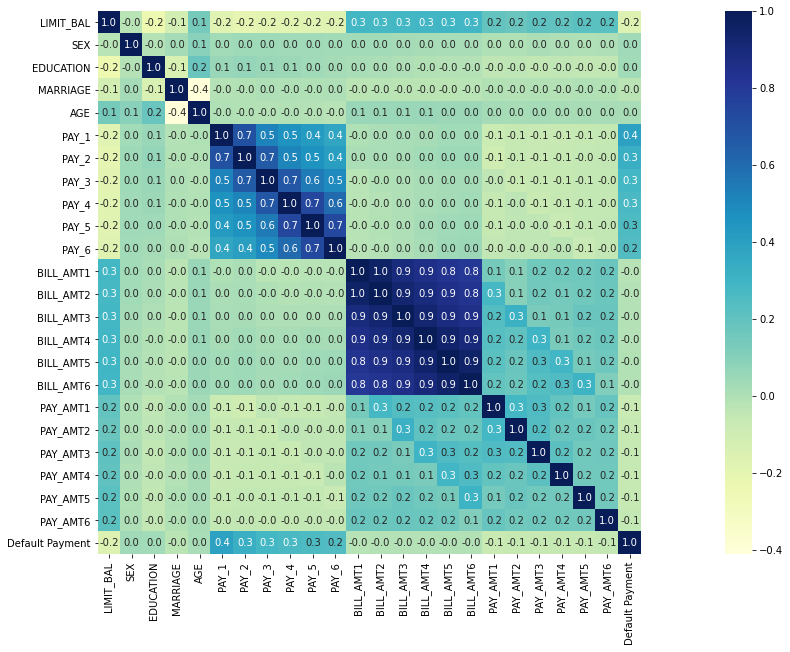

In [ ]:
# Correlation analysis
plt.subplots(figsize=(30,10))
sns.heatmap(data.corr(), square=True, annot=True, fmt=".1f", cmap="YlGnBu")
# It seems that PAY_1 has the highest correlation to the target Default Payment

# **Simple Feature Engineering and Preprocessing**

In [ ]:
Y = data['Default Payment']
#Y.head()

In [ ]:
# Order features first categorical and second continuous
feature_order = ['SEX',
                 'EDUCATION',
                 'MARRIAGE',
                 'PAY_1',
                 'PAY_2',
                 'PAY_3',
                 'PAY_4',
                 'PAY_5',
                 'PAY_6',
                 'LIMIT_BAL',
                 'AGE',
                 'BILL_AMT1',
                 'BILL_AMT2',
                 'BILL_AMT3',
                 'BILL_AMT4',
                 'BILL_AMT5',
                 'BILL_AMT6',
                 'PAY_AMT1',
                 'PAY_AMT2',
                 'PAY_AMT3',
                 'PAY_AMT4',
                 'PAY_AMT5',
                 'PAY_AMT6']

X = data[feature_order]
#X.head()

In [ ]:
# List of categorical features - preparation for LIME input
categorical_names = {}
categorical_names[0] = ['female', 'male']
categorical_names[1] = [1, 2, 3, 4]
categorical_names[2] = [1, 2, 3]
categorical_names[3] = [0, 1, 2, 3, 4, 5, 6, 7, 8]
categorical_names[4] = [0, 1, 2, 3, 4, 5, 6, 7, 8]
categorical_names[5] = [0, 1, 2, 3, 4, 5, 6, 7, 8]
categorical_names[6] = [0, 1, 2, 3, 4, 5, 6, 7, 8]
categorical_names[7] = [0, 1, 2, 3, 4, 5, 6, 7, 8]
categorical_names[8] = [0, 1, 2, 3, 4, 5, 6, 7, 8]

# List of continuous features
continuous_features = list(X.columns[9:])

In [ ]:
# Scale the data
scaler = MinMaxScaler(feature_range=(0, 1))

def scaleColumns(X, cols_to_scale):
  for col in cols_to_scale:
    X[col] = pd.DataFrame(scaler.fit_transform(pd.DataFrame(X[col])),
                          columns=[col])
    return X

X_scaled = scaleColumns(X,[continuous_features])
#X_scaled.head()

In [ ]:
# Split the data into train/test datasets
X_train, X_test, Y_train, Y_test = train_test_split(X_scaled, Y, test_size=0.2, random_state=12345)
#print(len(X_train)) 24000
#print(len(X_test)) 6000

# **Resampling**

In [ ]:
# Set random state and make the outputs stable
np.random.seed(12345)

In [ ]:
# Number of default payment and the ratio of it
# clearly imbalanced data, therefore resample with SMOTE
print(data["Default Payment"].value_counts())
print("Default Payment Percentage 0: {0:.2f} %".format(data[data["Default Payment"]==0].shape[0] / data.shape[0] * 100) )
print("Default Payment Percentage 1: {0:.2f} %".format(data[data["Default Payment"]==1].shape[0] / data.shape[0] * 100) )

0    23364
1     6636
Name: Default Payment, dtype: int64
Default Payment Percentage 0: 77.88 %
Default Payment Percentage 1: 22.12 %


In [ ]:
print(collections.Counter(Y_train))
#print(len(Y_train)) 24000
# The minority class 1 have just 5331 instances while the majority class 0 have 18669

Counter({0: 18669, 1: 5331})


In [ ]:
# Resample the train data
X_resampled, Y_resampled = SMOTE().fit_sample(X_train, Y_train)
# Convert the data to the same type as before SMOTE
X_train = pd.DataFrame(X_resampled, columns=feature_order)
Y_train = pd.Series(Y_resampled)

In [ ]:
print(collections.Counter(Y_train))
#print(len(Y_train)) 37338
# After applying SMOTE Method the classes are balanced

Counter({0: 18669, 1: 18669})


In [ ]:
# Already tested the Black-Box models for unbalanced and balanced data
# --> the balanced data have better recall and f1 score
# Metrics without SMOTE:
# Model  Precision   Recall  F1 Score  Accuracy       ROC
#  SVC   0.651106  0.406130  0.500236  0.823500  0.672820
#  RFC   0.637191  0.375479  0.472517  0.817667  0.658027
#  MLP   0.660274  0.369349  0.473710  0.821500  0.658263

# Metrics with SMOTE:
#Model   Precision   Recall  F1 Score  Accuracy       ROC
#  SVC   0.545605  0.504215  0.524094  0.800833  0.693747
#  RFC   0.521073  0.521073  0.521073  0.791667  0.693976
#  MLP   0.403059  0.686590  0.507937  0.710667  0.701974


# **Black-Box Model Training**

In [ ]:
# Fitting a Support Vector Machine Classifier
# Actually the SVC model don't need so much computing time
# but the lime package requires probabilities and
# therefore the default probability=False has to be changed to True
svc = SVC(kernel='linear', probability=True, random_state=12345)
%time svc.fit(X_train, Y_train)
svc_pred = svc.predict(X_test)

CPU times: user 5min 45s, sys: 733 ms, total: 5min 45s
Wall time: 5min 46s


In [ ]:
# Confusion Matrix
pd.crosstab(Y_test, svc_pred, rownames=['Actual'], colnames=['Predicted'])

Predicted,0,1
Actual,,
0,4073,622
1,628,677


In [ ]:
# Model performs
print(classification_report(Y_test, svc_pred))

              precision    recall  f1-score   support

           0       0.87      0.87      0.87      4695
           1       0.52      0.52      0.52      1305

    accuracy                           0.79      6000
   macro avg       0.69      0.69      0.69      6000
weighted avg       0.79      0.79      0.79      6000



In [ ]:
# Fitting a Random Forest Classifier
rfc = RandomForestClassifier(n_estimators=150, criterion='entropy', random_state=12345)
%time rfc.fit(X_train, Y_train)
rfc_pred = rfc.predict(X_test)

CPU times: user 29.4 s, sys: 16.9 ms, total: 29.4 s
Wall time: 29.5 s


In [ ]:
# Confusion Matrix
pd.crosstab(Y_test, rfc_pred, rownames=['Actual'], colnames=['Predicted'])

Predicted,0,1
Actual,,
0,4073,622
1,635,670


In [ ]:
# Model performs
print(classification_report(Y_test, rfc_pred))

              precision    recall  f1-score   support

           0       0.87      0.87      0.87      4695
           1       0.52      0.51      0.52      1305

    accuracy                           0.79      6000
   macro avg       0.69      0.69      0.69      6000
weighted avg       0.79      0.79      0.79      6000



In [ ]:
# Fitting a Multi-Layer Perceptron Classifier
mlp = MLPClassifier(hidden_layer_sizes=(10, 10, 10), max_iter=1000, random_state=12345)
%time mlp.fit(X_train, Y_train.values.ravel())
mlp_pred = mlp.predict(X_test)

CPU times: user 54 s, sys: 38.9 ms, total: 54 s
Wall time: 54.1 s


In [ ]:
# Confusion Matrix
pd.crosstab(Y_test, mlp_pred, rownames=['Actual'], colnames=['Predicted'])

Predicted,0,1
Actual,,
0,3566,1129
1,479,826


In [ ]:
# Model performs
print(classification_report(Y_test,mlp_pred))

              precision    recall  f1-score   support

           0       0.88      0.76      0.82      4695
           1       0.42      0.63      0.51      1305

    accuracy                           0.73      6000
   macro avg       0.65      0.70      0.66      6000
weighted avg       0.78      0.73      0.75      6000



In [ ]:
# Get a table for the metrics of the model performs
svc_prec = precision_score(Y_test, svc_pred)
svc_rec = recall_score(Y_test, svc_pred)
svc_f1 = f1_score(Y_test, svc_pred)
svc_acc = accuracy_score(Y_test, svc_pred)
svc_roc = roc_auc_score(Y_test, svc_pred)

rfc_prec = precision_score(Y_test, rfc_pred)
rfc_rec = recall_score(Y_test, rfc_pred)
rfc_f1 = f1_score(Y_test, rfc_pred)
rfc_acc = accuracy_score(Y_test, rfc_pred)
rfc_roc = roc_auc_score(Y_test, rfc_pred)

mlp_prec = precision_score(Y_test, mlp_pred)
mlp_rec = recall_score(Y_test, mlp_pred)
mlp_f1 = f1_score(Y_test, mlp_pred)
mlp_acc = accuracy_score(Y_test, mlp_pred)
mlp_roc = roc_auc_score(Y_test, mlp_pred)

metric = pd.DataFrame([['SVC', svc_prec, svc_rec, svc_f1, svc_acc, svc_roc]],
                      columns = ['Model', 'Precision', 'Recall', 'F1 Score', 'Accuracy', 'ROC'])

metric2 = pd.DataFrame([['RFC', rfc_prec, rfc_rec, rfc_f1, rfc_acc, rfc_roc]],
                      columns = ['Model', 'Precision', 'Recall', 'F1 Score', 'Accuracy', 'ROC'])

metric3 = pd.DataFrame([['MLP', mlp_prec, mlp_rec, mlp_f1, mlp_acc, mlp_roc]],
                      columns = ['Model', 'Precision', 'Recall', 'F1 Score', 'Accuracy', 'ROC'])

metric = metric.append([metric2, metric3], sort=False)
metric

,Model,Precision,Recall,F1 Score,Accuracy,ROC
0,SVC,0.521170,0.518774,0.519969,0.791667,0.693146
0,RFC,0.518576,0.513410,0.515980,0.790500,0.690464
0,MLP,0.422506,0.632950,0.506748,0.732000,0.696241


Text(0.5, 1.0, 'ROC')

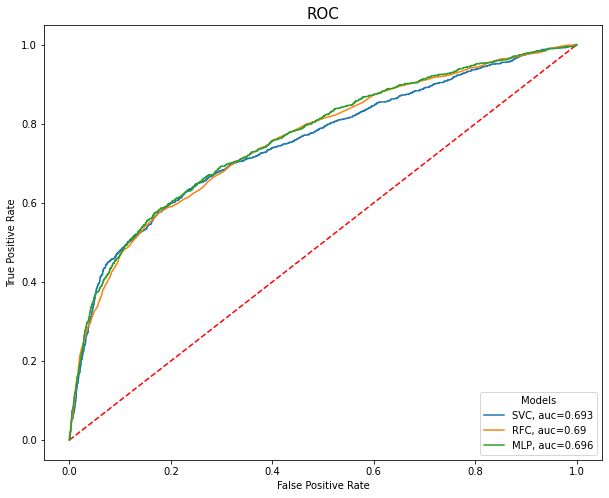

In [ ]:
# ROC Curve
probs_svc = svc.predict_proba(X_test)[:,1]
FPR1, TPR1, _ = metrics.roc_curve(Y_test, probs_svc)

probs_rfc = rfc.predict_proba(X_test)[:,1]
FPR2, TPR2, _ = metrics.roc_curve(Y_test, probs_rfc)

probs_mlp = mlp.predict_proba(X_test)[:,1]
FPR3, TPR3, _ = metrics.roc_curve(Y_test, probs_mlp)

plt.figure(figsize=(10,8))
plt.plot([0, 1], [0, 1], 'r--')
plt.plot(FPR1,TPR1,label="SVC, auc="+str(round(svc_roc,3)))
plt.plot(FPR2,TPR2,label="RFC, auc="+str(round(rfc_roc,3)))
plt.plot(FPR3,TPR3,label="MLP, auc="+str(round(mlp_roc,3)))
plt.legend(loc=4, title='Models', facecolor='white')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC', size=15)

# **Explainability**

## *Compare the LIME explanations of the Black-Box models at 4 different instances, additionally the Kernel SHAP explanation for MLP*

In [ ]:
predict_svc = lambda x: svc.predict_proba(x).astype(float)
predict_rfc = lambda x: rfc.predict_proba(x).astype(float)
predict_mlp = lambda x: mlp.predict_proba(x).astype(float)
#rfc.predict(X_test) array([1, 0, 0, ..., 0, 0, 0])
#rfc.predict_proba(X_test) array([[0.31333333, 0.68666667], [0.86, 0.14], [0.8, 0.2], ..]

In [ ]:
explainer_lime = lime.lime_tabular.LimeTabularExplainer(X_train.values,
                                                        class_names=Y_train.unique(),
                                                        feature_names = X_train.columns,
                                                        categorical_features = categorical_names,
                                                        verbose=True)
# verbose = True, so the intercept the LIME and Black-Box Modell prediction will be shown

Instance 1  - Actual Label: 0, Predicted Label: 0

In [ ]:
#i = 35
#print(X_test.iloc[i]) shows the instance as the actual data point
#print(Y_test.iloc[i])     0
#print(svc_pred[i])        0
#print(rfc_pred[i])        0
#print(mlp_pred[i])        0

In [ ]:
i = 35
%time exp = explainer_lime.explain_instance(X_test.iloc[i], predict_fn = predict_svc, num_features=5)
print(exp.score)
exp.show_in_notebook()
#exp.local_exp
exp.as_list()

Intercept 0.8694245959934388
Prediction_local [0.36850833]
Right: 0.35691118306794845
CPU times: user 3.98 s, sys: 324 ms, total: 4.3 s
Wall time: 3.97 s
0.862279738698042


[('PAY_1=0', -0.31115890778276223),
 ('PAY_2=0', -0.20141194001493934),
 ('PAY_3=0', 0.003953150195173049),
 ('BILL_AMT6 > 0.30', 0.00391378520958269),
 ('PAY_AMT6 > 0.01', 0.00378764933835298)]

In [ ]:
# The prediction of LIME model is the sum of the intercept and coefficients
0.8694245959934388 + (-0.31115890778276223) + (-0.20141194001493934) + 0.003953150195173049 + 0.00391378520958269 + 0.00378764933835298

0.36850833293884594

In [ ]:
i = 35
%time exp = explainer_lime.explain_instance(X_test.iloc[i], predict_fn = predict_rfc, num_features=5)
print(exp.score)
exp.show_in_notebook()

Intercept 0.6814565699659403
Prediction_local [0.32728557]
Right: 0.18666666666666668
CPU times: user 1.17 s, sys: 322 ms, total: 1.49 s
Wall time: 1.12 s
0.3749560960082812


In [ ]:
i = 35
%time exp = explainer_lime.explain_instance(X_test.iloc[i], predict_fn = predict_mlp, num_features=5)
print(exp.score)
exp.show_in_notebook()

Intercept 1.011229539754286
Prediction_local [0.2923108]
Right: 0.2066158066500271
CPU times: user 979 ms, sys: 250 ms, total: 1.23 s
Wall time: 930 ms
0.44401059872943155


In [ ]:
explainer = shap.KernelExplainer(predict_mlp, X_train)
shap.initjs()

i = 35
%time shap_values = explainer.shap_values(X_test.iloc[i], nsamples=100)
shap.force_plot(explainer.expected_value[1], shap_values[1], X_test.iloc[i], link="identity")

Using 37338 background data samples could cause slower run times. Consider using shap.sample(data, K) or shap.kmeans(data, K) to summarize the background as K samples.


CPU times: user 43.7 s, sys: 1.74 s, total: 45.4 s
Wall time: 41.6 s


In [ ]:
shap_values[1]

array([-0.00403602,  0.        , -0.04542741, -0.05777129, -0.04465046,
       -0.00629676, -0.02115615, -0.00933667,  0.        ,  0.        ,
        0.        ,  0.        ,  0.        ,  0.        ,  0.        ,
        0.        ,  0.        ,  0.        , -0.01378795,  0.        ,
        0.        , -0.10593468,  0.        ])

Instance 2 - Actual Label: 1, Predicted Label: 1

In [ ]:
#i = 2675
#print(X_test.iloc[i])
#print(Y_test.iloc[i])     1
#print(svc_pred[i])        1
#print(rfc_pred[i])        1
#print(mlp_pred[i])        1

In [ ]:
i = 2675
%time exp = explainer_lime.explain_instance(X_test.iloc[i], predict_fn = predict_svc, num_features=5)
print(exp.score)
exp.show_in_notebook()

Intercept 0.6165365833753855
Prediction_local [0.73449843]
Right: 0.7547813416124128
CPU times: user 3.99 s, sys: 312 ms, total: 4.3 s
Wall time: 3.95 s
0.6501115199111637


In [ ]:
i = 2675
%time exp = explainer_lime.explain_instance(X_test.iloc[i], predict_fn = predict_rfc, num_features=5)
print(exp.score)
exp.show_in_notebook()

Intercept 0.5174806674038772
Prediction_local [0.6404675]
Right: 0.74
CPU times: user 1.13 s, sys: 300 ms, total: 1.43 s
Wall time: 1.09 s
0.39781062691381536


In [ ]:
i = 2675
%time exp = explainer_lime.explain_instance(X_test.iloc[i], predict_fn = predict_mlp, num_features=5)
print(exp.score)
exp.show_in_notebook()

Intercept 0.7628486133153582
Prediction_local [0.79443109]
Right: 0.881724734200468
CPU times: user 966 ms, sys: 267 ms, total: 1.23 s
Wall time: 930 ms
0.5244831116770893


In [ ]:
explainer = shap.KernelExplainer(predict_mlp, X_train)
shap.initjs()

i = 2675
%time shap_values = explainer.shap_values(X_test.iloc[i], nsamples=100)
shap.force_plot(explainer.expected_value[1], shap_values[1], X_test.iloc[i], link="identity")

Using 37338 background data samples could cause slower run times. Consider using shap.sample(data, K) or shap.kmeans(data, K) to summarize the background as K samples.


CPU times: user 44.4 s, sys: 618 ms, total: 45 s
Wall time: 41.7 s


In [ ]:
shap_values[1]

array([0.        , 0.        , 0.        , 0.32525366, 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.04145788,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        ])

Instance 3 - Actual Label: 0, Predicted Label: 1

In [ ]:
#i = 555
#print(X_test.iloc[i])
#print(Y_test.iloc[i])    0
#print(svc_pred[i])       1
#print(rfc_pred[i])       1
#print(mlp_pred[i])       1

In [ ]:
i = 555
%time exp = explainer_lime.explain_instance(X_test.iloc[i], predict_fn = predict_svc, num_features=5)
print(exp.score)
exp.show_in_notebook()

Intercept 0.42261127891875716
Prediction_local [0.92256416]
Right: 0.8792847399742162
CPU times: user 3.98 s, sys: 294 ms, total: 4.28 s
Wall time: 3.92 s
0.5653251192321365


In [ ]:
i = 555
%time exp = explainer_lime.explain_instance(X_test.iloc[i], predict_fn = predict_rfc, num_features=5)
print(exp.score)
exp.show_in_notebook()

Intercept 0.42565547811343807
Prediction_local [0.61834952]
Right: 0.6933333333333334
CPU times: user 1.15 s, sys: 316 ms, total: 1.46 s
Wall time: 1.11 s
0.4065419550916338


In [ ]:
i = 555
%time exp = explainer_lime.explain_instance(X_test.iloc[i], predict_fn = predict_mlp, num_features=5)
print(exp.score)
exp.show_in_notebook()

Intercept 0.575174170239024
Prediction_local [0.88712598]
Right: 0.8822306520804934
CPU times: user 973 ms, sys: 245 ms, total: 1.22 s
Wall time: 922 ms
0.47404336021716476


In [ ]:
explainer = shap.KernelExplainer(predict_mlp, X_train)
shap.initjs()

i = 555
%time shap_values = explainer.shap_values(X_test.iloc[i], nsamples=100)
shap.force_plot(explainer.expected_value[1], shap_values[1], X_test.iloc[i], link="identity")

Using 37338 background data samples could cause slower run times. Consider using shap.sample(data, K) or shap.kmeans(data, K) to summarize the background as K samples.


CPU times: user 44.5 s, sys: 573 ms, total: 45.1 s
Wall time: 41.7 s


In [ ]:
shap_values[1]

array([0.        , 0.        , 0.        , 0.23069281, 0.10266177,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.03386288, 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        ])

Instance 4 - Actual Label: 1, Predicted Label: 0



In [ ]:
#i = 1880
#print(X_test.iloc[i])
#print(Y_test.iloc[i])    1
#print(svc_pred[i])       0
#print(rfc_pred[i])       0
#print(mlp_pred[i])       0

In [ ]:
i = 1880
%time exp = explainer_lime.explain_instance(X_test.iloc[i], predict_fn = predict_svc, num_features=5)
print(exp.score)
exp.show_in_notebook()

Intercept 0.882546408232073
Prediction_local [0.36422746]
Right: 0.3569330122544934
CPU times: user 4.04 s, sys: 317 ms, total: 4.36 s
Wall time: 4 s
0.8700084063477235


In [ ]:
i = 1880
%time exp = explainer_lime.explain_instance(X_test.iloc[i], predict_fn = predict_rfc, num_features=5)
print(exp.score)
exp.show_in_notebook()

Intercept 0.64399487276505
Prediction_local [0.41942654]
Right: 0.21333333333333335
CPU times: user 1.17 s, sys: 308 ms, total: 1.48 s
Wall time: 1.11 s
0.3326753833437992


In [ ]:
i = 1880
%time exp = explainer_lime.explain_instance(X_test.iloc[i], predict_fn = predict_mlp, num_features=5)
print(exp.score)
exp.show_in_notebook()

Intercept 1.0729312450809303
Prediction_local [0.32117]
Right: 0.3831789850241079
CPU times: user 965 ms, sys: 255 ms, total: 1.22 s
Wall time: 918 ms
0.47499633409421527


In [ ]:
explainer = shap.KernelExplainer(predict_mlp, X_train)
shap.initjs()

i = 1880
%time shap_values = explainer.shap_values(X_test.iloc[i], nsamples=100)
shap.force_plot(explainer.expected_value[1], shap_values[1], X_test.iloc[i], link="identity")

Using 37338 background data samples could cause slower run times. Consider using shap.sample(data, K) or shap.kmeans(data, K) to summarize the background as K samples.


CPU times: user 44 s, sys: 632 ms, total: 44.6 s
Wall time: 41.1 s


In [ ]:
shap_values[1]

array([ 0.        , -0.04568959, -0.01980776, -0.07857919, -0.0114412 ,
        0.        ,  0.        , -0.01191077, -0.01679955,  0.        ,
        0.02530845,  0.01675877,  0.        ,  0.        ,  0.        ,
        0.01032664,  0.        ,  0.        ,  0.        ,  0.        ,
        0.        ,  0.        ,  0.        ])

## *Choose the MLP model at the Instance 2 and compare LIME results for different kernels*

In [ ]:
explainer_lime = lime.lime_tabular.LimeTabularExplainer(X_train.values,
                                                        class_names=Y_train.unique(),
                                                        feature_names = X_train.columns,
                                                        categorical_features = categorical_names,
                                                        kernel_width=5,
                                                        verbose=True)

i = 2675
%time exp = explainer_lime.explain_instance(X_test.iloc[i], predict_fn = predict_mlp, num_features=5)
print(exp.score)
exp.show_in_notebook()

Intercept 0.7524639858316332
Prediction_local [0.79832487]
Right: 0.881724734200468
CPU times: user 985 ms, sys: 272 ms, total: 1.26 s
Wall time: 940 ms
0.525888938508656


In [ ]:
explainer_lime = lime.lime_tabular.LimeTabularExplainer(X_train.values,
                                                        class_names=Y_train.unique(),
                                                        feature_names = X_train.columns,
                                                        categorical_features = categorical_names,
                                                        kernel_width=4,
                                                        verbose=True)

i = 2675
%time exp = explainer_lime.explain_instance(X_test.iloc[i], predict_fn = predict_mlp, num_features=5)
print(exp.score)
exp.show_in_notebook()

Intercept 0.7517766638664278
Prediction_local [0.79204986]
Right: 0.881724734200468
CPU times: user 962 ms, sys: 261 ms, total: 1.22 s
Wall time: 921 ms
0.529183404046643


In [ ]:
explainer_lime = lime.lime_tabular.LimeTabularExplainer(X_train.values,
                                                        class_names=Y_train.unique(),
                                                        feature_names = X_train.columns,
                                                        categorical_features = categorical_names,
                                                        kernel_width=3,
                                                        verbose=True)

i = 2675
%time exp = explainer_lime.explain_instance(X_test.iloc[i], predict_fn = predict_mlp, num_features=5)
print(exp.score)
exp.show_in_notebook()

Intercept 0.744718161731869
Prediction_local [0.80177693]
Right: 0.881724734200468
CPU times: user 961 ms, sys: 258 ms, total: 1.22 s
Wall time: 915 ms
0.5362884852763443


In [ ]:
explainer_lime = lime.lime_tabular.LimeTabularExplainer(X_train.values,
                                                        class_names=Y_train.unique(),
                                                        feature_names = X_train.columns,
                                                        categorical_features = categorical_names,
                                                        kernel_width=2,
                                                        verbose=True)

i = 2675
%time exp = explainer_lime.explain_instance(X_test.iloc[i], predict_fn = predict_mlp, num_features=5)
print(exp.score)
exp.show_in_notebook()

Intercept 0.7452880577664628
Prediction_local [0.80482674]
Right: 0.881724734200468
CPU times: user 982 ms, sys: 252 ms, total: 1.23 s
Wall time: 944 ms
0.5581746440247689


In [ ]:
explainer_lime = lime.lime_tabular.LimeTabularExplainer(X_train.values,
                                                        class_names=Y_train.unique(),
                                                        feature_names = X_train.columns,
                                                        categorical_features = categorical_names,
                                                        kernel_width=1,
                                                        verbose=True)

i = 2675
%time exp = explainer_lime.explain_instance(X_test.iloc[i], predict_fn = predict_mlp, num_features=5)
print(exp.score)
exp.show_in_notebook()

Intercept 0.6136595605085354
Prediction_local [0.76491398]
Right: 0.881724734200468
CPU times: user 956 ms, sys: 264 ms, total: 1.22 s
Wall time: 921 ms
0.6020468732140188


## *Compare the SP-LIME across the three Black-Box models, additionally the global Kernel SHAP explanation for MLP*

In [ ]:
explainer_lime = lime.lime_tabular.LimeTabularExplainer(X_train.values,
                                                        class_names=Y_train.unique(),
                                                        feature_names = X_train.columns,
                                                        categorical_features = categorical_names,
                                                        verbose=False)

#verbose=false, so the information about local explainder don't show up

CPU times: user 1min 22s, sys: 8.07 s, total: 1min 30s
Wall time: 1min 21s


[<Figure size 432x288 with 1 Axes>, <Figure size 432x288 with 1 Axes>]

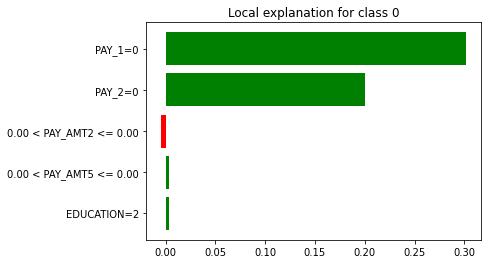

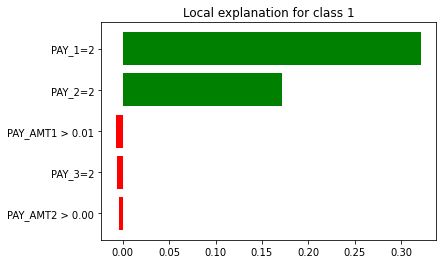

In [ ]:
%time sp_obj = submodular_pick.SubmodularPick(explainer_lime, X_train.values, predict_svc, sample_size=20, num_features=5, num_exps_desired=2)
[exp.as_pyplot_figure(label=exp.available_labels()[0]) for exp in sp_obj.sp_explanations]

CPU times: user 24.1 s, sys: 8.19 s, total: 32.3 s
Wall time: 22.8 s


[<Figure size 432x288 with 1 Axes>, <Figure size 432x288 with 1 Axes>]

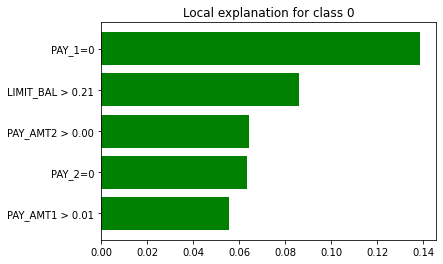

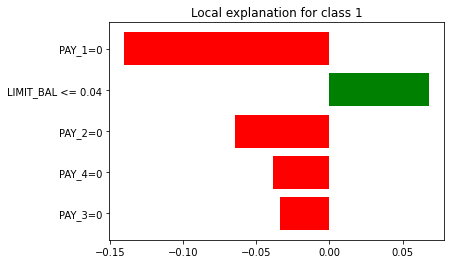

In [ ]:
%time sp_obj = submodular_pick.SubmodularPick(explainer_lime, X_train.values, predict_rfc, sample_size=20, num_features=5, num_exps_desired=2)
[exp.as_pyplot_figure(label=exp.available_labels()[0]) for exp in sp_obj.sp_explanations]

CPU times: user 22.4 s, sys: 6.87 s, total: 29.3 s
Wall time: 22.9 s


[<Figure size 432x288 with 1 Axes>, <Figure size 432x288 with 1 Axes>]

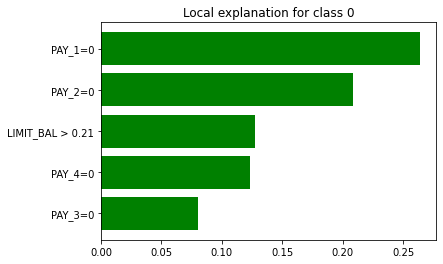

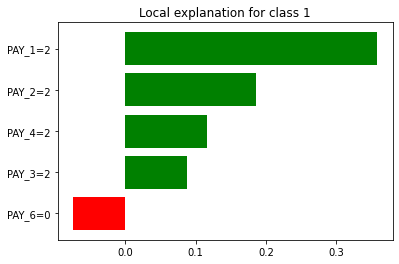

In [ ]:
%time sp_obj = submodular_pick.SubmodularPick(explainer_lime, X_train.values, predict_mlp, sample_size=20, num_features=5, num_exps_desired=2)
[exp.as_pyplot_figure(label=exp.available_labels()[0]) for exp in sp_obj.sp_explanations]

In [ ]:
# Sampling data from the training set to reduce time
# Running without the kmeans end up with ram crash
X_train_summary = shap.kmeans(X_train, 10)


CPU times: user 30min 48s, sys: 18min 35s, total: 49min 23s
Wall time: 26min 35s


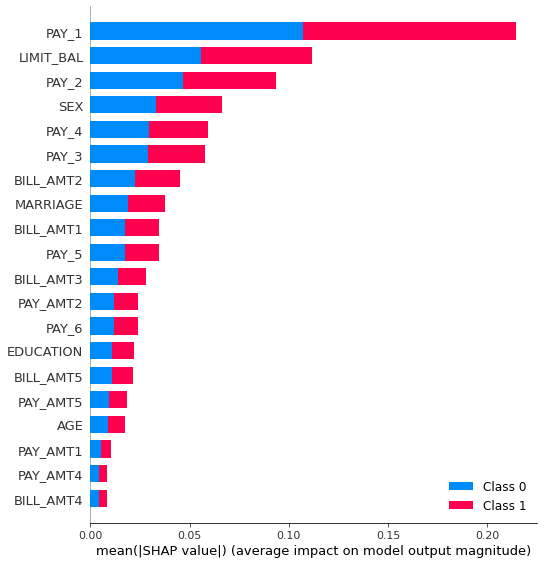

In [ ]:
explainer = shap.KernelExplainer(predict_mlp, X_train_summary)
%time shap_values = explainer.shap_values(X_test)
shap.initjs()
shap.summary_plot(shap_values, X_test)